Using https://github.com/ultralytics/ultralytics YOLOv8 to build a gym back machine classifier using datasets of images from google images, tiktok, bilibili, youtube videos,and Roboflow datasets. Training classes consist of:
    "seated mid row": 0,
    "seated cable row": 1,
    "cable lat pulldown": 2,
    "machine lat pulldown": 3,
    "chest supported T-bar row": 4,
    "Landmine t-bar row": 5,
    "machine reverse fly": 6,


### 1. Preparation

### 1.1 Installing dependancies:

In [ ]:
%pip install ultralytics

In [2]:
from ultralytics import YOLO
import GymDetector.utils.main_utils as helpers # includes dataset downloader, file unzipper, and YOLO label+image plotter, and more
import matplotlib.pyplot as plt # for plotting
%matplotlib inline

### 1.2 Preparing dataset:

In [27]:
# missing = helpers.find_and_move_missing_images('D:\My DL Workstation/Yolo v8 Gym equipment/data/images/train',
#                                                'D:\My DL Workstation/Yolo v8 Gym equipment/data/labels/train',
#                                                'D:\My DL Workstation/Yolo v8 Gym equipment/data/images/train/New folder')

# print(missing)

['New folder']


In [26]:
# missing = helpers.find_and_move_missing_txts('D:\My DL Workstation/Yolo v8 Gym equipment/data/images/train',
#                                              'D:\My DL Workstation/Yolo v8 Gym equipment/data/labels/train',
#                                              'D:\My DL Workstation/Yolo v8 Gym equipment/data/images/train/New folder')

# print(missing)

[]


In [6]:
# helpers.extract_files('C:/Users/MASTE/Downloads/Compressed/workout.v8i.yolov8/valid/labels',
#                       'C:/Users/MASTE/Downloads/Compressed/workout.v8i.yolov8/valid/images',
#                       [1,2])

Extraction completed successfully.


In [9]:
#helpers.extract_files('C:/Users/MASTE/Downloads/Compressed/healnion.v1i.yolov8/test/labels',
#                      'C:/Users/MASTE/Downloads/Compressed/healnion.v1i.yolov8/test/images',
#                       [7])

Extraction completed successfully.


In [11]:
# helpers.extract_files('C:/Users/MASTE/Downloads/Compressed/Workout_5.v1i.yolov8/valid/labels',
#                       'C:/Users/MASTE/Downloads/Compressed/Workout_5.v1i.yolov8/valid/images',
#                       [1])

Extraction completed successfully.


In [6]:
# helpers.extract_files('D:/My DL Workstation/Yolo v8 Gym equipment/data collection/datasets/GymBro.v2i.yolov8/test/labels',
#                       'D:/My DL Workstation/Yolo v8 Gym equipment/data collection/datasets/GymBro.v2i.yolov8/test/images',
#                       [6,12,18])

Extraction completed successfully.


In [21]:
# helpers.change_first_num('D:/My DL Workstation/Yolo v8 Gym equipment/data collection/3/val/labels',3)

In [7]:
# helpers.unique_categories('D:/My DL Workstation/Yolo v8 Gym equipment/data/labels/train', 7)

uniques: {'3', '6', '0', '2', '4', '5', '1'}
with nums: []


In [23]:
# names = []
# names_2 = []
# for i in os.listdir('D:/My DL Workstation/Yolo v8 Gym equipment/data/images/train'):
#     name, ext = os.path.splitext(i)
#     name = name + ''
#     names.append(name)
# for i in os.listdir('D:/My DL Workstation/Yolo v8 Gym equipment/data/labels/train'):
#     name, ext = os.path.splitext(i)
#     names_2.append(name)
# repeated_names = [name for i, name in enumerate(names) if name in names[:i] or name in names[i + 1:]]
# print("Repeated Names:", set(repeated_names))

Repeated Names: set()


In [17]:
# class_mapping = {
#     "seated mid row": 0,
#     "seated cable row": 1,
#     "cable lat pulldown": 2,
#     "machine lat pulldown": 3,
#     "chest supported T-bar row": 4,
#     "Landmine t-bar row": 5,
#     "machine reverse fly": 6,
# }
# helpers.convert_to_yolo('D:/My DL Workstation/Yolo v8 Gym equipment/data collection/6/json it/json',
#             'D:/My DL Workstation/Yolo v8 Gym equipment/data collection/6/json it/yolo', class_mapping)

### 2.Visualizing training data along with bounding boxes:

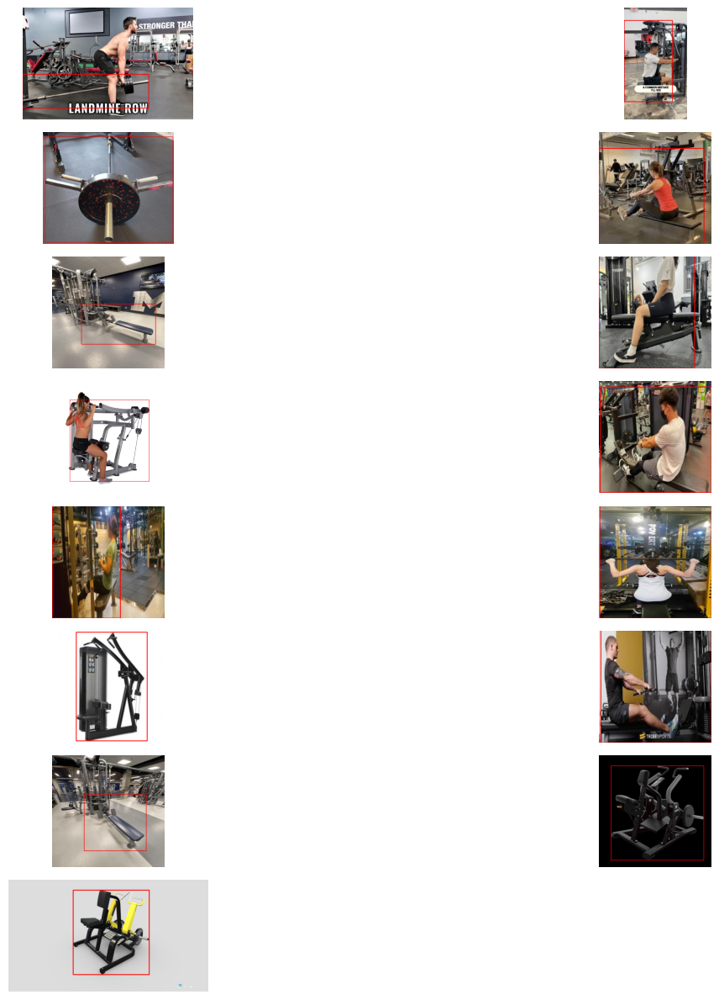

In [16]:
# Visualize a few training images along with their annotations
helpers.plot_yolo(
    image_paths='D:/My DL Workstation/Yolo v8 Gym equipment/data/images/train', 
    label_paths='D:/My DL Workstation/Yolo v8 Gym equipment/data/labels/train',
    num_samples=15,
)

### 3. Building a YOLOv8 nano model from scratch:

### 3.1 Training:

In [17]:
model = YOLO("yolov8n.yaml")  # build a new model from scratch

model.train(data="config.yaml", epochs=1000)  # train the model


                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.475      0.585      0.543      0.332

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
    22/1000      2.48G       1.18      1.943      1.683         41        640: 100%|██████████| 229/229 [00:24<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.374      0.508      0.424       0.24

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
    23/1000      2.48G      1.181      1.918      1.685         42        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.633      0.4

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.851      0.771      0.866      0.607

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
    62/1000      2.48G     0.9563      1.374       1.46         35        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.791      0.767      0.859      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
    63/1000      2.48G     0.9629      1.382      1.467         36        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.817      0.8

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.867      0.882      0.918      0.687

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   102/1000      2.48G     0.8243      1.123      1.344         37        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.858      0.846       0.91      0.685

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   103/1000      2.48G     0.8249        1.1      1.344         34        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.876      0.8

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343        0.9      0.909       0.94      0.709

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   142/1000      2.48G     0.7538     0.9595       1.28         38        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.889      0.901      0.935      0.709

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   143/1000      2.48G     0.7471     0.9536      1.274         43        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.886      0.9

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.898      0.918      0.943      0.728

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   182/1000      2.48G     0.6928     0.8696       1.22         41        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.894      0.921      0.942      0.729

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   183/1000      2.48G       0.71     0.8892      1.234         48        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.869      0.9

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.883      0.932      0.944       0.74

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   222/1000      2.48G      0.655     0.7895      1.195         31        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.898      0.919      0.944      0.741

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   223/1000      2.48G     0.6529     0.7782      1.194         41        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.894      0.9

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.888       0.94      0.949      0.746

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   262/1000      2.48G     0.6247     0.7451      1.174         48        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343       0.89       0.94       0.95      0.748

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   263/1000      2.48G     0.6179     0.7358      1.167         37        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.889       0.

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.892      0.935       0.95      0.753

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   302/1000      2.48G     0.5942     0.6914      1.147         41        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.892      0.935       0.95      0.752

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   303/1000      2.48G      0.603     0.7014      1.149         34        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.893      0.9

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04
                   all        332        343      0.893      0.941      0.954      0.751

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   342/1000      2.48G     0.5691     0.6502      1.118         35        640: 100%|██████████| 229/229 [00:28<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.924      0.906      0.954      0.751

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   343/1000      2.48G     0.5678     0.6412      1.124         39        640: 100%|██████████| 229/229 [00:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03
                   all        332        343      0.894      0.9

### 3.2 Displaying the validation metrics:

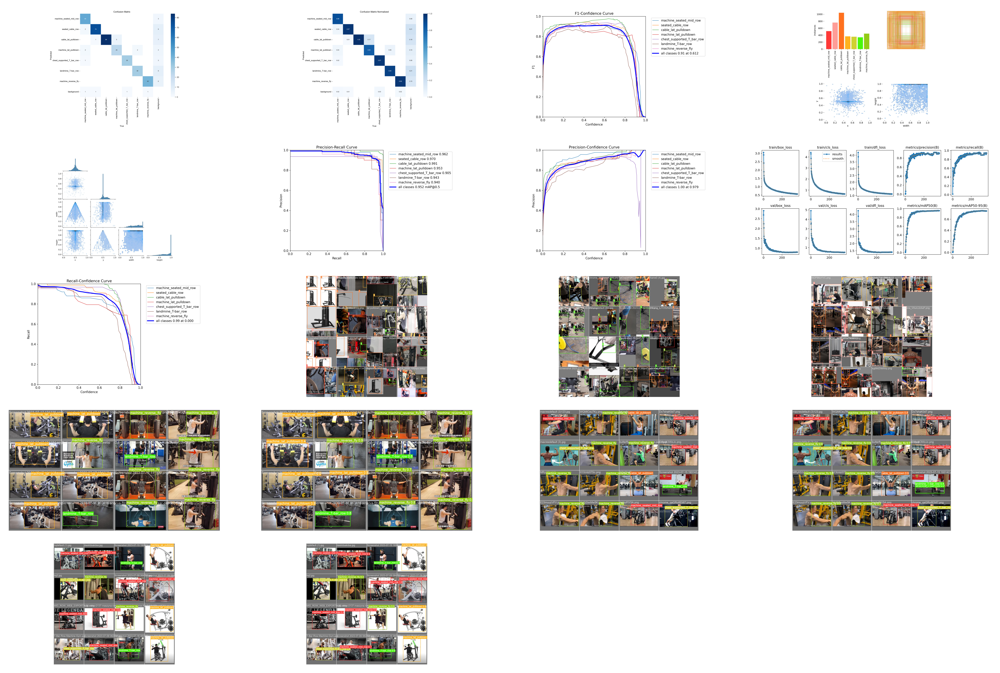

In [3]:
# Using a function that plots images in the val folder in a 4xn subplot
helpers.plot_4x('./runs/detect/train4')

### 4. Using a pre-trained  medium model:

### 4.1 Training:

In [3]:
model_pretrained = YOLO("yolov8m.pt")  # load a pretrained model (recommended for training)

model_pretrained.train(data="config.yaml", epochs=1000)  # train the model

New https://pypi.org/project/ultralytics/8.0.147 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.141  Python-3.10.9 torch-2.0.1 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)
engine\trainer: task=detect, mode=train, model=yolov8m.pt, data=config.yaml, epochs=1000, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina

     8/1000      7.29G      1.006       1.39      1.446         41        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:05
                   all        332        343      0.756      0.698      0.785      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     9/1000      7.13G     0.9765      1.375      1.431         45        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:05
                   all        332        343      0.744      0.721      0.805      0.546

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
    10/1000      7.31G     0.9705      1.348      1.425         37        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P         

    48/1000      7.28G     0.6411     0.7465      1.184         41        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:05
                   all        332        343      0.904      0.916      0.944      0.753

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
    49/1000      7.14G     0.6402     0.7432      1.185         35        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04
                   all        332        343      0.928      0.934      0.955      0.744

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
    50/1000      7.28G     0.6421     0.7463      1.188         44        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P         

    88/1000      7.28G     0.5326     0.5765      1.106         36        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04
                   all        332        343      0.959      0.959      0.972      0.788

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
    89/1000      7.31G      0.521     0.5801      1.099         43        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:05
                   all        332        343      0.952      0.941      0.968      0.799

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
    90/1000       7.3G     0.5201     0.5669       1.09         41        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P         

   128/1000      7.28G     0.4567     0.4805      1.053         36        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04
                   all        332        343      0.934       0.95      0.966      0.788

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   129/1000      7.13G      0.449     0.4958      1.051         33        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04
                   all        332        343       0.94      0.961      0.963      0.793

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   130/1000      7.14G     0.4655     0.4951      1.064         46        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P         

   168/1000      7.29G     0.4172     0.4423      1.022         38        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:05
                   all        332        343      0.933      0.951      0.969      0.806

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   169/1000      7.14G     0.4147     0.4316      1.024         41        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04
                   all        332        343       0.93      0.967      0.969      0.809

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
   170/1000       7.3G     0.4115     0.4382      1.029         42        640: 100%|██████████| 229/229 [00:44<00:00,  
                 Class     Images  Instances      Box(P         

### 4.2 Plotting the validation metrics:

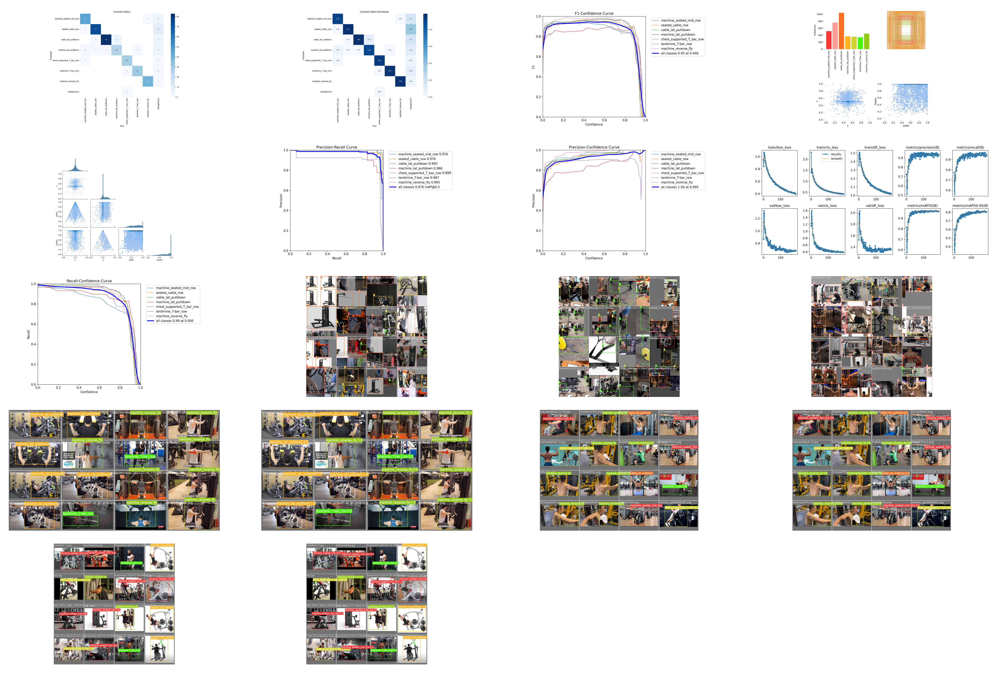

In [5]:
helpers.plot_4x('./runs/detect/train3')

### 4.3 Predicting on the test set:

In [ ]:
model_pretrained = YOLO('D:/My DL Workstation/Yolo v8 Gym equipment/notebook/runs/detect/train3/weights/best.pt')

for i in range(7):
    res0 = model_pretrained.predict(f'D:/My DL Workstation/Yolo v8 Gym equipment/data collection/{i}/test', save=True, conf=0.5)

### 4.4 Predicting on a video and saving the predictions:

In [ ]:
model_pretrained = YOLO('D:/My DL Workstation/Yolo v8 Gym equipment/notebook/runs/detect/train3/weights/best.pt')
model_pretrained.predict("D:/My DL Workstation/Yolo v8 Gym equipment/media/test.mp4",
               save=True)

### 5. Displaying  model's misclassifications:

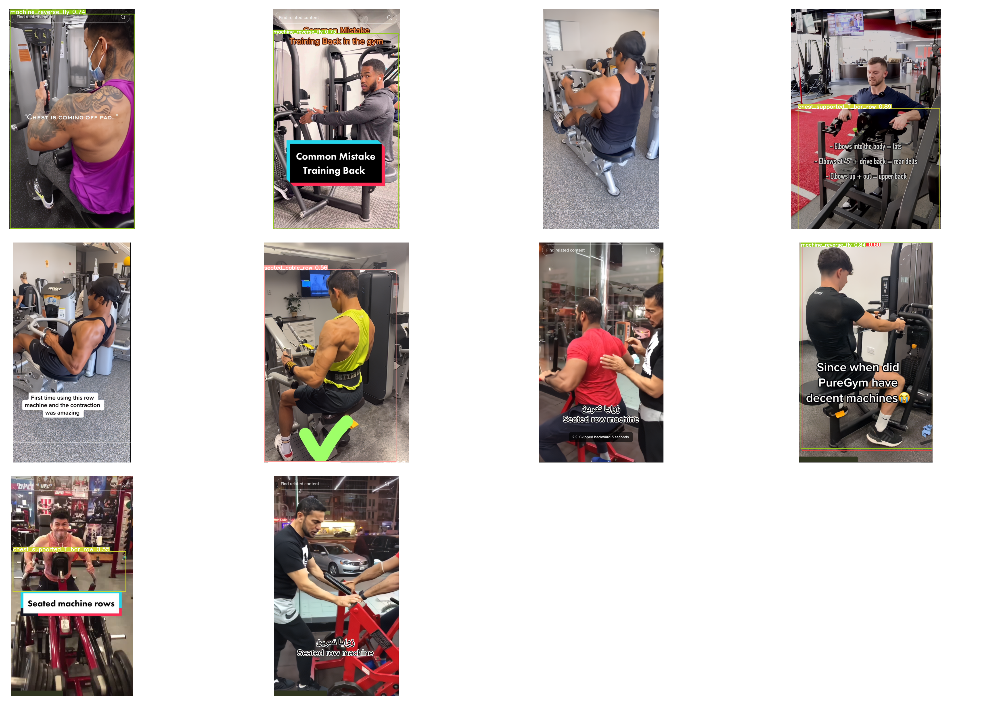

In [18]:
helpers.plot_4x('D:/My DL Workstation/Yolo v8 Gym equipment/pretrained miss/0 miss')

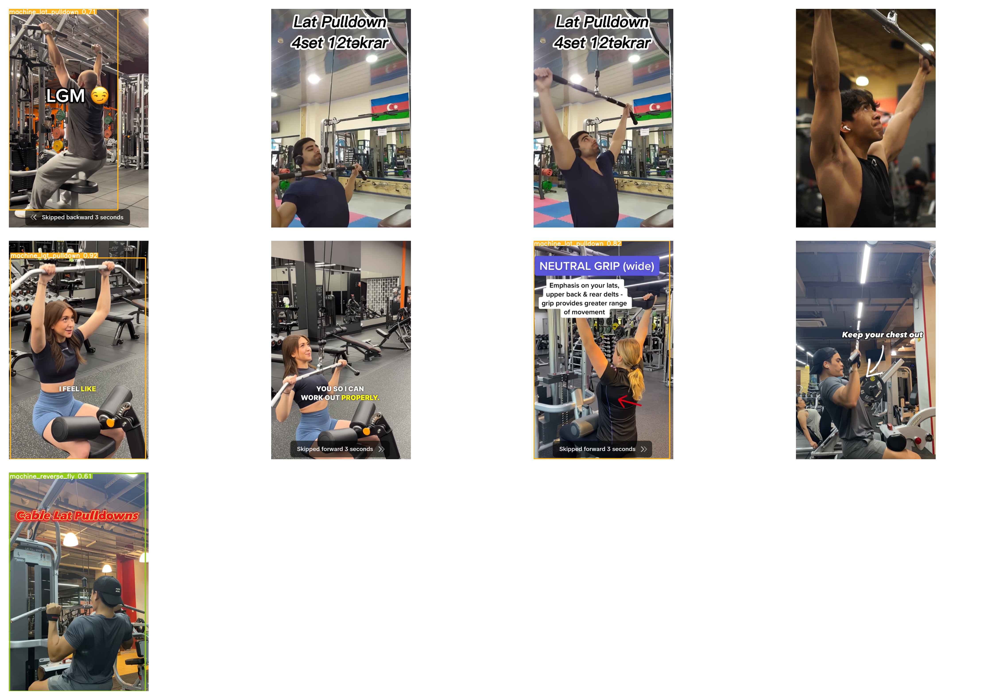

In [20]:
helpers.plot_4x('D:/My DL Workstation/Yolo v8 Gym equipment/pretrained miss/2 miss')

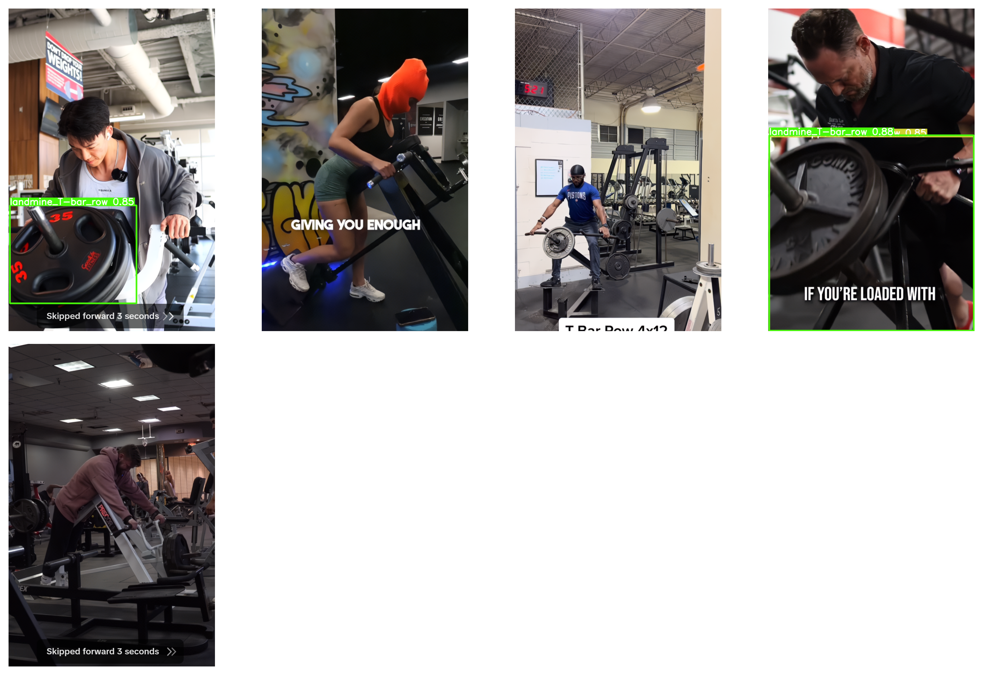

In [21]:
helpers.plot_4x('D:/My DL Workstation/Yolo v8 Gym equipment/pretrained miss/4 miss')